# methane plume visualizer by band differencing

### import packages

In [1]:
import matplotlib.pyplot as plt
import numpy as np
import os
import math
import statsmodels.api as sm
import pandas as pd
import time
import pickle as pkl
from sentinel_parser import Tile
from sentinel2_functions import get_SZA, get_VZA, get_instrument_name, build_threshold_mask, clean_threshold_mask
from s2cloudless import S2PixelCloudDetector
from scipy import interpolate
from scipy.optimize import minimize
from skimage.measure import block_reduce
from sklearn.linear_model import HuberRegressor, Ridge

### process and save band data and cloud mask

In [2]:
#name, reference_date = "39RUJ", "2021-06-01" # Saudi Arabia
#name = "32TQM" # Rome
#name = "32SKA" # Algeria
name = "13SGR" # EDF Spot; Stanford
dates_to_save = []

#plume_lat, plume_long = 31.6585, 5.9053 # for 32SKA, Algeria
#plume_lat, plume_long = 31.730775, -102.041952 # for 13SGR, EDF Spot
plume_lat, plume_long = 32.05285, -102.30076 # for 13SGR, Stanford
#plume_lat, plume_long = 25.578494, 49.224666 # for 39RUJ, Saudi Arabia (?)
#plume_lat, plume_long = 41.8609, 12.4602 # for 32TQM, Rome (for cloud)
#plume_lat, plume_long = 41.9901, 12.5948 # for 32TQM, Rome (for cloud)
#plume_lat, plume_long = 31.98988, 6.60733 # for 32SKA, Algeria (for cloud)

####################
cache = "/Users/DanielShen/Documents/Opportunities/2021M - Methane Research/Code/Data"
cache_raw = os.path.join(cache,"Raw")
cache_name = os.path.join(cache,"Processed",name)
if not os.path.exists(cache_name):
    os.mkdir(cache_name)

all_bands = ["B01", "B02", "B03", "B04", "B05", "B06", "B07", "B08", "B8A", "B09", "B10", "B11", "B12"]
cloud_bands = ["B01", "B02", "B04", "B05", "B08", "B8A", "B09", "B10", "B11", "B12"] # must be subset of all_bands
cloud_detector = S2PixelCloudDetector(threshold=0.4, average_over=22, dilation_size=11, all_bands=False)

for date_to_save in dates_to_save:
    tile = Tile(cache_raw,name,date_to_save,all_bands) # load Tile
    cache_date = os.path.join(cache_name,date_to_save)
    os.mkdir(cache_date) # make folder for that date
    scene_bands_cloud = [] # scenes for cloud_detector
    for band in all_bands: # regrid to 20m resolution (as B11 & B12); each cropped to 200x200 pixels
        row_band,col_band = tile.geodetictorowcol(band,plume_lat,plume_long)
        scale = len(tile.bands[band])/len(tile.bands["B12"])
        if int(scale) == 2: # scale = 2 (10980 pixels, 10m resolution)
            tile_regrid = block_reduce(tile.bands[band][row_band-200:row_band+200,\
                                       col_band-200:col_band+200],block_size=(2,2),func=np.mean)/10000
        elif int(scale) == 1: # scale = 1 (5490 pixels, 20m resolution)
            tile_regrid = tile.bands[band][row_band-100:row_band+100,col_band-100:col_band+100]/10000
        else: # scale = 1/3 (1830 pixels, 60m resolution)
            x,y = np.arange(-34*3,34*3,3),np.arange(-34*3,34*3,3)
            XX,YY = np.meshgrid(np.arange(-100,100),np.arange(-100,100))
            f = interpolate.RegularGridInterpolator((x,y),tile.bands[band][row_band-34:row_band+34,\
                                                    col_band-34:col_band+34],method='nearest')
            tile_regrid = np.transpose(f((XX,YY),method='nearest'))/10000
        np.save(os.path.join(cache_date,band),tile_regrid)
        if band in cloud_bands:
            scene_bands_cloud.append(tile_regrid) # cloud mask will assume no neighbor effects
    scene_bands_cloud = np.array(scene_bands_cloud).transpose((1,2,0))
    np.save(os.path.join(cache_date,"cloud"),cloud_detector.get_cloud_masks(scene_bands_cloud)) # save cloud mask

### open band data

In [ ]:
#name, reference_date = "39RUJ", "2021-06-01" # Saudi Arabia

#name = "32TQM" # Rome
#reference_dates = ["2021-06-19"] # for cloud cover testing; use with 32TQM Rome

#name = "32SKA" # Algeria
#plume_dates = ["2019-11-20"]
#non_plume_dates = ["2019-10-06"]
#plume_dates = ["2019-10-11","2019-10-14","2019-10-16","2019-10-21","2019-11-20","2019-11-30","2019-12-03",\
#               "2019-12-20","2020-01-17"]
#non_plume_dates = ["2019-01-17","2019-02-16","2019-03-18","2019-04-17","2019-05-17","2019-06-16","2019-07-06",\
#                   "2019-07-11","2019-07-16","2019-07-23","2019-07-28","2019-08-02","2019-08-10","2019-08-17",\
#                   "2019-08-22","2019-08-27","2019-09-01","2019-09-11","2019-09-14","2019-09-16","2019-09-19",\
#                   "2019-09-24","2019-09-26","2019-09-29","2019-10-01","2019-10-04","2019-10-06"]
#reference_dates = non_plume_dates + plume_dates
# 2019-09-21 completely cloudy
#reference_dates = non_plume_dates + plume_dates

name = "13SGR" # EDF Spot; Stanford
#plume_dates = ["2020-07-01","2020-07-04","2020-07-06","2020-07-09","2020-07-11","2020-07-14","2020-07-16",\
#               "2020-07-19","2020-07-21","2020-07-24","2020-07-26","2020-07-29","2020-07-31","2020-08-03",\
#               "2020-08-05","2020-08-08","2020-08-10","2020-08-13","2020-08-15","2020-08-18","2020-08-20",\
#               "2020-08-23","2020-08-25","2020-08-28","2020-08-30","2020-09-02","2020-09-04","2020-09-07",\
#               "2020-09-09","2020-09-12","2020-09-14","2020-09-17","2020-09-19","2020-09-22","2020-09-24",\
#               "2020-09-27","2020-09-29","2020-10-04","2020-10-07","2020-10-09","2020-10-12","2020-10-14",\
#               "2020-10-17","2020-10-19","2020-10-22","2020-10-24","2020-10-27","2020-10-29"]
#non_plume_dates = ["2020-06-26"]
#dates_desc = "2020-06-26 to 2020-10-29 Every 2-3 Minus 2020-06-29"
plume_dates = ["2021-06-04","2021-06-06","2021-06-09","2021-06-11","2021-06-14","2021-06-16","2021-06-19",\
               "2021-06-21","2021-06-24","2021-06-26","2021-06-29","2021-07-01","2021-07-04","2021-07-06",\
               "2021-07-09","2021-07-11","2021-07-14","2021-07-16","2021-07-19","2021-07-21","2021-07-24",\
               "2021-07-26","2021-07-29","2021-07-31","2021-08-03","2021-08-05","2021-08-08","2021-08-10",\
               "2021-08-13","2021-08-15","2021-08-18","2021-08-20"]
non_plume_dates = ["2021-06-01"]
dates_desc = "2021-06-01 to 2021-08-20 Every 2-3"
reference_dates = non_plume_dates + plume_dates
#reference_dates = ["2020-06-26","2020-07-01","2020-07-04","2020-07-06","2020-07-09","2020-07-11","2020-07-14",\
#                   "2020-07-16","2020-07-19","2020-07-21","2020-07-24","2020-07-26","2020-07-29","2020-07-31",\
#                   "2020-08-03","2020-08-05","2020-08-08","2020-08-10","2020-08-13","2020-08-15","2020-08-18",\
#                   "2020-08-20","2020-08-23","2020-08-25","2020-08-28","2020-08-30","2020-09-02","2020-09-04",\
#                   "2020-09-07","2020-09-09","2020-09-12","2020-09-14","2020-09-17","2020-09-19","2020-09-22",\
#                   "2020-09-24","2020-09-27","2020-09-29","2020-10-04","2020-10-07","2020-10-09","2020-10-12",\
#                   "2020-10-14","2020-10-17","2020-10-19","2020-10-22","2020-10-24","2020-10-27","2020-10-29"]

####################
cache = "/Users/DanielShen/Documents/Opportunities/2021M - Methane Research/Code/Data"
cache_raw = os.path.join(cache,"raw") # necessary for sza and vza retrieval
cache_name = os.path.join(cache,"Processed",name)

#scenes = {}
b11,b11_avg,b12,b12_avg,cloud = {},{},{},{},{} # dictionaries with data indexed by reference_date

for reference_date in reference_dates:
#    scenes[reference_date] = {} # data of each reference_date will be contained in a subdictionary
#    for band in bands:
#        scenes[reference_date][band] = tile.bands[band]/10000
    cache_date = os.path.join(cache_name,reference_date)
    cloud[reference_date] = np.load(os.path.join(cache_date,"cloud.npy"))
    b11[reference_date] = np.load(os.path.join(cache_date,"B11.npy"))
    b12[reference_date] = np.load(os.path.join(cache_date,"B12.npy"))
    b11[reference_date][cloud[reference_date]==1] = float('nan')
    b12[reference_date][cloud[reference_date]==1] = float('nan')
    b11_avg[reference_date] = np.nanmedian(b11[reference_date]) # nanmedian or nanmean
    b12_avg[reference_date] = np.nanmedian(b12[reference_date])
    print(reference_date,np.sum(cloud[reference_date])==200**2,np.sum(cloud[reference_date])/200**2) # check cloud cover

### solar zenith angle

In [ ]:
color_all = True # use True if plume_dates unknown

####################
sza_dict = {}

plt.figure()
if not color_all:
    for non_plume_date in non_plume_dates:
        sza_dict[non_plume_date] = get_SZA(cache_raw,name,non_plume_date)
    plt.plot(sza_dict.values(),np.zeros(len(sza_dict)),'b.',label="non-plume")
    for k in range(len(plume_dates)): # capacity for 4 plume dates
        sza_dict[plume_dates[k]] = get_SZA(cache_raw,name,plume_dates[k])
        plt.plot(sza_dict[plume_dates[k]],0,'rygm'[k]+'.',label=f"plume ({plume_dates[k]})")
    plt.legend(bbox_to_anchor=(1.04,1), loc="upper left")
else:
    for reference_date in reference_dates:
        sza_dict[reference_date] = get_SZA(cache_raw,name,reference_date)
    plt.scatter(sza_dict.values(),np.zeros(len(reference_dates)),s=10,c=range(len(reference_dates)),cmap="gist_rainbow")
plt.xlabel("Solar zenith angle")
plt.title("Solar Zenith Angles of Observations")

sza_dict

### viewing zenith angle

In [ ]:
####################
vza_dict = {}
for reference_date in reference_dates:
    vza_dict[reference_date] = get_VZA(cache_raw,name,reference_date)
    vza_dict[reference_date]['instrument'] = get_instrument_name(cache_raw,name,reference_date)

vza_dict

### SBMP

In [ ]:
plume_dates_SBMP = plume_dates[:]
non_plume_dates_SBMP = [non_plume_dates[-1]]

####################
for plume_date in plume_dates_SBMP:
    for non_plume_date in non_plume_dates_SBMP:
        if np.sum(~np.isnan(b12[non_plume_date])) == 0 or np.sum(~np.isnan(b12[plume_date])) == 0:
            c = float('nan')
        else:
            reg = sm.OLS(b12[non_plume_date].flatten(),b12[plume_date].flatten().reshape(-1,1),missing="drop").fit()
            c = reg.params[0]

        deltaR = (c*b12[plume_date] - b12[non_plume_date]) / b12[non_plume_date]

        plt.figure()
        plt.imshow(deltaR,cmap="RdBu",vmin=-0.1,vmax=0.1)
#        plt.colorbar()
#        plt.title(f"SBMP Fractional Reflectance Change, {plume_date} Minus {non_plume_date}")
        plt.title(f"SBMP ∆R, {plume_date} Minus {non_plume_date}")

### MBSP

/Users/DanielShen/opt/anaconda3/envs/sentinel2_research_3.6/lib/python3.6/site-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


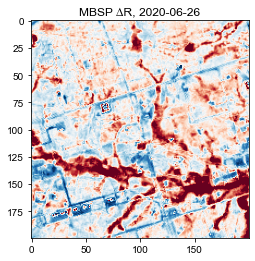

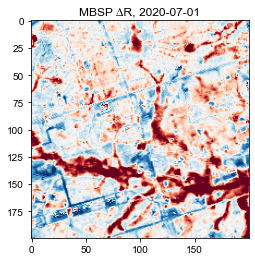

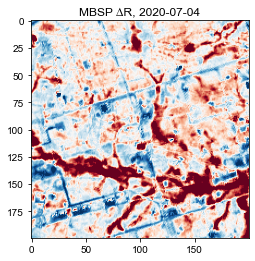

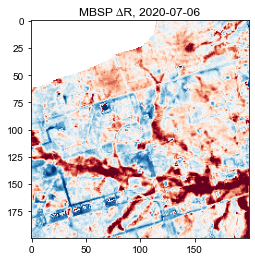

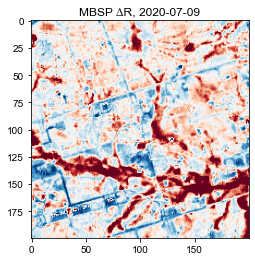

...

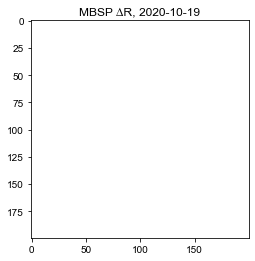

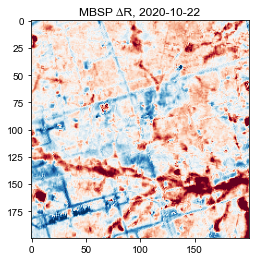

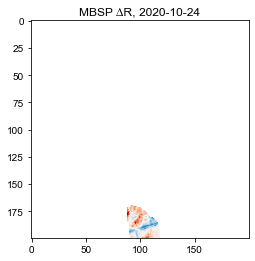

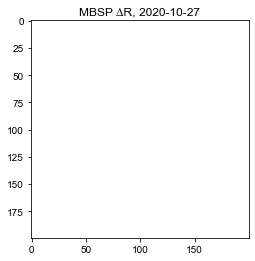

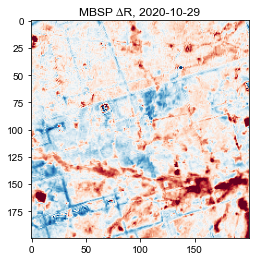

In [33]:
#dates = plume_dates[:]
dates = reference_dates[:]

####################
for date in dates:
    if np.sum(~np.isnan(b11[date])) == 0 or np.sum(~np.isnan(b12[date])) == 0:
        c = float('nan')
    else:
        reg = sm.OLS(b11[date].flatten(),b12[date].flatten().reshape(-1,1),missing="drop").fit()
        c = reg.params[0]

    deltaR = (c*b12[date] - b11[date]) / b11[date]

    plt.figure()
    plt.imshow(deltaR,cmap="RdBu",vmin=-0.1,vmax=0.1)
#    plt.colorbar()
#    plt.title(f"MBSP Fractional Reflectance Change, {date}")
    plt.title(f"MBSP ∆R, {date}")

### MBMP

In [ ]:
plume_dates_MBMP = plume_dates[:]
non_plume_dates_MBMP = [non_plume_dates[-1]]

####################
deltaR_MBMP = {}
deltaM_MBMP = {} # delta M for methane; negative of delta R

for plume_date in plume_dates_MBMP:
    deltaR_MBMP[plume_date] = {}
    deltaM_MBMP[plume_date] = {}
    for non_plume_date in non_plume_dates_MBMP:
        if np.sum(~np.isnan(b11[plume_date])) == 0 or np.sum(~np.isnan(b12[plume_date])) == 0:
            c_plume = float('nan')
        else:
            reg_plume = sm.OLS(b11[plume_date].flatten(),b12[plume_date].flatten().reshape(-1,1),missing="drop").fit()
            c_plume = reg_plume.params[0]
        if np.sum(~np.isnan(b11[non_plume_date])) == 0 or np.sum(~np.isnan(b12[non_plume_date])) == 0:
            c_non_plume = float('nan')
        else:
            reg_non_plume = sm.OLS(b11[non_plume_date].flatten(),b12[non_plume_date].flatten().reshape(-1,1),missing="drop").fit()
            c_non_plume = reg_non_plume.params[0]

        deltaR_plume = (c_plume*b12[plume_date] - b11[plume_date]) / b11[plume_date]
        deltaR_non_plume = (c_non_plume*b12[non_plume_date] - b11[non_plume_date]) / b11[non_plume_date]
        deltaR_MBMP[plume_date][non_plume_date] = deltaR_plume - deltaR_non_plume
        deltaM_MBMP[plume_date][non_plume_date] = -deltaR_MBMP[plume_date][non_plume_date]
        
        plt.figure()
        plt.imshow(deltaR_MBMP[plume_date][non_plume_date],cmap="RdBu",vmin=-0.1,vmax=0.1)
#        plt.colorbar()
#        plt.title(f"MBMP Fractional Reflectance Change with Image-wide Fit Coefficient, {plume_date} Minus {non_plume_date}")
        plt.title(f"MBMP ∆R, {plume_date} Minus {non_plume_date}")

### MBMP with by-pixel spectral fit coefficients

#### initial computation

In [4]:
use_scaling = True
factors = "None" # ["Others","Intercept","None"]
others_desc = "Quadratic and Trigonometric SZA Factors"
reg_method = "OLS" # ["OLS","LAD","Huber","Ridge"]

####################
r2,c = np.empty((2,200,200)) # zero-intercept regressions of B11 vs. B12
r2_int,c_int,d_int = np.empty((3,200,200)) # with-intercept regressions of B11 vs. B12
r2_others,c_b12,c_sza,c_b12b12,c_b12sza,c_szasza,c_sin,c_cos = np.empty((8,200,200)) # zero-intercept regressions of B11 vs. B12 & other factors

deltaR_pixel,deltaM_pixel = {},{} # computed delta R and delta M (methane; negative of delta R) for each date

t0 = time.time()
for i in range(200):
    if i%10 == 0:
        print(i,time.time()-t0)
    for j in range(200):
        b11_pixel,b12_pixel = np.array([[],[]]) # reflectances of particular pixel over all passes
        if factors == "Others":
            sza_pixel,b12b12_pixel,b12sza_pixel,szasza_pixel,sin_pixel,cos_pixel = np.array([[],[],[],[],[],[]])
        for reference_date in reference_dates:
            if cloud[reference_date][i,j] == 0: # check for cloud nan
                if use_scaling:
                    b11_pixel = np.append(b11_pixel,b11[reference_date][i,j]/b11_avg[reference_date])
                    b12_pixel = np.append(b12_pixel,b12[reference_date][i,j]/b12_avg[reference_date])
                else:
                    b11_pixel = np.append(b11_pixel,b11[reference_date][i,j])
                    b12_pixel = np.append(b12_pixel,b12[reference_date][i,j])
                if factors == "Others":
                    sza_pixel = np.append(sza_pixel,sza_dict[reference_date])
        if factors == "Others":
            b12b12_pixel = b12_pixel**2
            b12sza_pixel = b12_pixel*sza_pixel
            szasza_pixel = sza_pixel**2
            sin_pixel = np.sin(np.radians(sza_pixel))
            cos_pixel = np.cos(np.radians(sza_pixel))
        if factors == "Others":
            if reg_method == "OLS":
                reg_others = sm.OLS(b11_pixel,np.concatenate((b12_pixel.reshape(-1,1),sza_pixel.reshape(-1,1),\
                    b12b12_pixel.reshape(-1,1),b12sza_pixel.reshape(-1,1),szasza_pixel.reshape(-1,1),\
                    sin_pixel.reshape(-1,1),cos_pixel.reshape(-1,1)),axis=1)).fit()
                r2_others[i,j] = reg_others.rsquared
                c_b12[i,j],c_sza[i,j],c_b12b12[i,j],c_b12sza[i,j],c_szasza[i,j],c_sin[i,j],c_cos[i,j] = reg_others.params
            elif reg_method == "LAD":
                reg_others = sm.QuantReg(b11_pixel,np.concatenate((b12_pixel.reshape(-1,1),sza_pixel.reshape(-1,1),\
                    b12b12_pixel.reshape(-1,1),b12sza_pixel.reshape(-1,1),szasza_pixel.reshape(-1,1),\
                    sin_pixel.reshape(-1,1),cos_pixel.reshape(-1,1)),axis=1)).fit(q=0.5)
                r2_others[i,j] = reg_others.prsquared
                c_b12[i,j],c_sza[i,j],c_b12b12[i,j],c_b12sza[i,j],c_szasza[i,j],c_sin[i,j],c_cos[i,j] = reg_others.params
            elif reg_method == "Huber":
                reg_others = HuberRegressor(fit_intercept=False).fit(np.concatenate((b12_pixel.reshape(-1,1),\
                    sza_pixel.reshape(-1,1),b12b12_pixel.reshape(-1,1),b12sza_pixel.reshape(-1,1),\
                    szasza_pixel.reshape(-1,1),sin_pixel.reshape(-1,1),cos_pixel.reshape(-1,1)),axis=1),b11_pixel)
                c_b12[i,j],c_sza[i,j],c_b12b12[i,j],c_b12sza[i,j],c_szasza[i,j],c_sin[i,j],c_cos[i,j] = reg_others.coef_
            elif reg_method == "Ridge":
                reg_others = Ridge(fit_intercept=False).fit(np.concatenate((b12_pixel.reshape(-1,1),\
                    sza_pixel.reshape(-1,1),b12b12_pixel.reshape(-1,1),b12sza_pixel.reshape(-1,1),\
                    szasza_pixel.reshape(-1,1),sin_pixel.reshape(-1,1),cos_pixel.reshape(-1,1)),axis=1),b11_pixel)
                c_b12[i,j],c_sza[i,j],c_b12b12[i,j],c_b12sza[i,j],c_szasza[i,j],c_sin[i,j],c_cos[i,j] = reg_others.coef_
        elif factors == "Intercept":
            if reg_method == "OLS":
                reg_int = sm.OLS(b11_pixel,sm.add_constant(b12_pixel)).fit()
                r2_int[i,j] = reg_int.rsquared
                d_int[i,j],c_int[i,j] = reg_int.params
            elif reg_method == "LAD":
                reg_int = sm.QuantReg(b11_pixel,sm.add_constant(b12_pixel)).fit(q=0.5)
                r2_int[i,j] = reg_int.prsquared
                d_int[i,j],c_int[i,j] = reg_int.params
            elif reg_method == "Huber":
                reg_int = HuberRegressor().fit(b12_pixel.reshape(-1,1),b11_pixel)
                c_int[i,j] = reg_int.coef_
                d_int[i,j] = reg_int.intercept_
            elif reg_method == "Ridge":
                reg_int = Ridge().fit(b12_pixel.reshape(-1,1),b11_pixel)
                c_int[i,j] = reg_int.coef_
                d_int[i,j] = reg_int.intercept_
        elif factors == "None":
            if reg_method == "OLS":
                reg = sm.OLS(b11_pixel,b12_pixel).fit()
                r2[i,j] = reg.rsquared
                c[i,j] = reg.params[0]
            elif reg_method == "LAD":
                reg = sm.QuantReg(b11_pixel,b12_pixel).fit(q=0.5) # can increase tolerance to run faster
                r2[i,j] = reg.prsquared
                c[i,j] = reg.params[0]
            elif reg_method == "Huber":
                reg = HuberRegressor(fit_intercept=False).fit(b12_pixel.reshape(-1,1),b11_pixel) # can increase tolerance to run faster
                c[i,j] = reg.coef_
            elif reg_method == "Ridge":
                reg = Ridge(fit_intercept=False).fit(b12_pixel.reshape(-1,1),b11_pixel) # can increase tolerance to run faster
                c[i,j] = reg.coef_
t1 = time.time()
print(t1-t0)

for reference_date in reference_dates:
    if factors == "Others":
        if use_scaling:
            deltaR_pixel[reference_date] = (np.multiply(c_b12,b12[reference_date]/b12_avg[reference_date]) + c_sza*sza_dict[reference_date] \
                                        + np.multiply(c_b12b12,(b12[reference_date]/b12_avg[reference_date])**2) + np.multiply(c_b12sza,b12[reference_date]/b12_avg[reference_date]*sza_dict[reference_date]) \
                                        + c_szasza*sza_dict[reference_date]**2 + c_sin*np.sin(np.radians(sza_dict[reference_date])) + c_cos*np.cos(np.radians(sza_dict[reference_date])) \
                                        - b11[reference_date]/b11_avg[reference_date]) / (b11[reference_date]/b11_avg[reference_date])
        else:
            deltaR_pixel[reference_date] = (np.multiply(c_b12,b12[reference_date]) + c_sza*sza_dict[reference_date] \
                                        + np.multiply(c_b12b12,b12[reference_date]**2) + np.multiply(c_b12sza,b12[reference_date]*sza_dict[reference_date]) \
                                        + c_szasza*sza_dict[reference_date]**2 + c_sin*np.sin(np.radians(sza_dict[reference_date])) + c_cos*np.cos(np.radians(sza_dict[reference_date])) \
                                        - b11[reference_date]) / b11[reference_date]
    elif factors == "Intercept":
        if use_scaling:
            deltaR_pixel[reference_date] = (np.multiply(c_int,b12[reference_date]/b12_avg[reference_date]) + d_int - b11[reference_date]/b11_avg[reference_date]) / (b11[reference_date]/b11_avg[reference_date])
        else:
            deltaR_pixel[reference_date] = (np.multiply(c_int,b12[reference_date]) + d_int - b11[reference_date]) / b11[reference_date]
    else:
        if use_scaling:
            deltaR_pixel[reference_date] = (np.multiply(c,b12[reference_date]/b12_avg[reference_date]) - b11[reference_date]/b11_avg[reference_date]) / (b11[reference_date]/b11_avg[reference_date])
        else:
            deltaR_pixel[reference_date] = (np.multiply(c,b12[reference_date]) - b11[reference_date]) / b11[reference_date]
    deltaM_pixel[reference_date] = -deltaR_pixel[reference_date]

0 0.001870870590209961
10 2.15944504737854
20 4.271466016769409
30 6.589069843292236
40 9.443513870239258
50 12.638305902481079
60 14.868713140487671
70 17.11713218688965
80 22.507148027420044
90 26.581751108169556
100 28.807027101516724
110 30.8885760307312
120 33.00352597236633
130 34.912707805633545
140 36.7725248336792
150 38.701191902160645
160 40.663233041763306
170 44.072118043899536
180 46.75111103057861
190 49.03389286994934
52.908961057662964


#### save variables

In [5]:
####################
if factors == "Others":
    if use_scaling:
        cache_scalstan = f"/Users/DanielShen/Documents/Opportunities/2021M - Methane Research/Code/Outputs/{name}/{dates_desc}/Scaling with {others_desc}"
    else:
        cache_scalstan = f"/Users/DanielShen/Documents/Opportunities/2021M - Methane Research/Code/Outputs/{name}/{dates_desc}/Standard with {others_desc}"
elif factors == "Intercept":
    if use_scaling:
        cache_scalstan = f"/Users/DanielShen/Documents/Opportunities/2021M - Methane Research/Code/Outputs/{name}/{dates_desc}/Scaling with Intercept"
    else:
        cache_scalstan = f"/Users/DanielShen/Documents/Opportunities/2021M - Methane Research/Code/Outputs/{name}/{dates_desc}/Standard with Intercept"
else:
    if use_scaling:
        cache_scalstan = f"/Users/DanielShen/Documents/Opportunities/2021M - Methane Research/Code/Outputs/{name}/{dates_desc}/Scaling"
    else:
        cache_scalstan = f"/Users/DanielShen/Documents/Opportunities/2021M - Methane Research/Code/Outputs/{name}/{dates_desc}/Standard"
if not os.path.exists(cache_scalstan):
    os.mkdir(cache_scalstan)

cache_reg = os.path.join(cache_scalstan,reg_method)
if not os.path.exists(cache_reg):
    os.mkdir(cache_reg)

cache_vars = os.path.join(cache_reg,"Variables")
if not os.path.exists(cache_vars):
    os.mkdir(cache_vars)

pkl.dump(deltaR_pixel,open(os.path.join(cache_vars,"deltaR_pixel"),'wb'))
pkl.dump(deltaM_pixel,open(os.path.join(cache_vars,"deltaM_pixel"),'wb'))
if factors == "Others":
    np.save(os.path.join(cache_vars,"r2_others"),r2_others)
    np.save(os.path.join(cache_vars,"c_b12"),c_b12)
    np.save(os.path.join(cache_vars,"c_sza"),c_sza)
    np.save(os.path.join(cache_vars,"c_b12b12"),c_b12b12)
    np.save(os.path.join(cache_vars,"c_b12sza"),c_b12sza)
    np.save(os.path.join(cache_vars,"c_szasza"),c_szasza)
    np.save(os.path.join(cache_vars,"c_sin"),c_sin)
    np.save(os.path.join(cache_vars,"c_cos"),c_cos)
elif factors == "Intercept":
    np.save(os.path.join(cache_vars,"r2_int"),r2_int)
    np.save(os.path.join(cache_vars,"c_int"),c_int)
    np.save(os.path.join(cache_vars,"d_int"),d_int)
else:
    np.save(os.path.join(cache_vars,"r2"),r2)
    np.save(os.path.join(cache_vars,"c"),c)

#### load variables

In [48]:
use_scaling = True
factors = "None" # ["Others","Intercept","None"]
others_desc = "Quadratic and Trigonometric SZA Factors"
reg_method = "OLS" # ["OLS","LAD","Huber","Ridge"]

####################
if factors == "Others":
    if use_scaling:
        cache_vars = f"/Users/DanielShen/Documents/Opportunities/2021M - Methane Research/Code/Outputs/{name}/{dates_desc}/Scaling with {others_desc}/{reg_method}/Variables"
    else:
        cache_vars = f"/Users/DanielShen/Documents/Opportunities/2021M - Methane Research/Code/Outputs/{name}/{dates_desc}/Standard with {others_desc}/{reg_method}/Variables"
elif factors == "Intercept":
    if use_scaling:
        cache_vars = f"/Users/DanielShen/Documents/Opportunities/2021M - Methane Research/Code/Outputs/{name}/{dates_desc}/Scaling with Intercept/{reg_method}/Variables"
    else:
        cache_vars = f"/Users/DanielShen/Documents/Opportunities/2021M - Methane Research/Code/Outputs/{name}/{dates_desc}/Standard with Intercept/{reg_method}/Variables"
else:
    if use_scaling:
        cache_vars = f"/Users/DanielShen/Documents/Opportunities/2021M - Methane Research/Code/Outputs/{name}/{dates_desc}/Scaling/{reg_method}/Variables"
    else:
        cache_vars = f"/Users/DanielShen/Documents/Opportunities/2021M - Methane Research/Code/Outputs/{name}/{dates_desc}/Standard/{reg_method}/Variables"

deltaR_pixel = pkl.load(open(os.path.join(cache_vars,"deltaR_pixel"),'rb'))
deltaM_pixel = pkl.load(open(os.path.join(cache_vars,"deltaM_pixel"),'rb'))
if factors == "Others":
    r2_others = np.load(os.path.join(cache_vars,"r2_others.npy"))
    c_b12 = np.load(os.path.join(cache_vars,"c_b12.npy"))
    c_sza = np.load(os.path.join(cache_vars,"c_sza.npy"))
    c_b12b12 = np.load(os.path.join(cache_vars,"c_b12b12.npy"))
    c_b12sza = np.load(os.path.join(cache_vars,"c_b12sza.npy"))
    c_szasza = np.load(os.path.join(cache_vars,"c_szasza.npy"))
    c_sin = np.load(os.path.join(cache_vars,"c_sin.npy"))
    c_cos = np.load(os.path.join(cache_vars,"c_cos.npy"))
elif factors == "Intercept":
    r2_int = np.load(os.path.join(cache_vars,"r2_int.npy"))
    c_int = np.load(os.path.join(cache_vars,"c_int.npy"))
    d_int = np.load(os.path.join(cache_vars,"d_int.npy"))
else:
    r2 = np.load(os.path.join(cache_vars,"r2.npy"))
    c = np.load(os.path.join(cache_vars,"c.npy"))

#### plot (and save)

/Users/DanielShen/opt/anaconda3/envs/sentinel2_research_3.6/lib/python3.6/site-packages/ipykernel_launcher.py:49: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


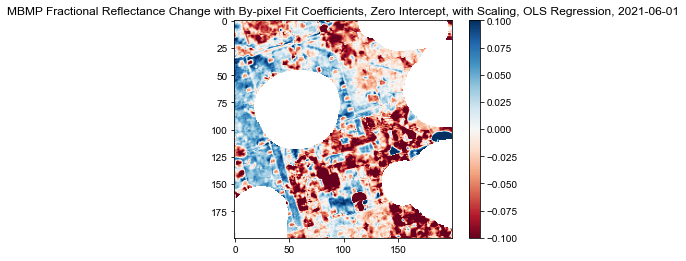

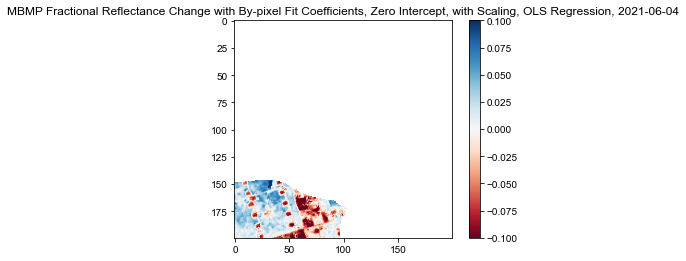

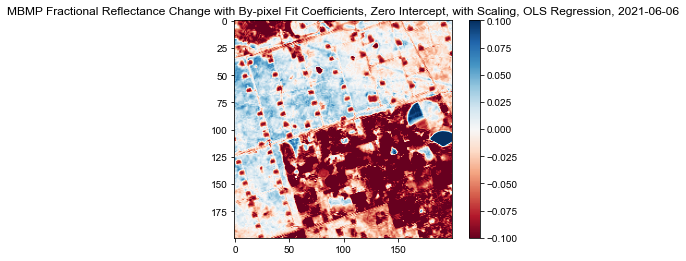

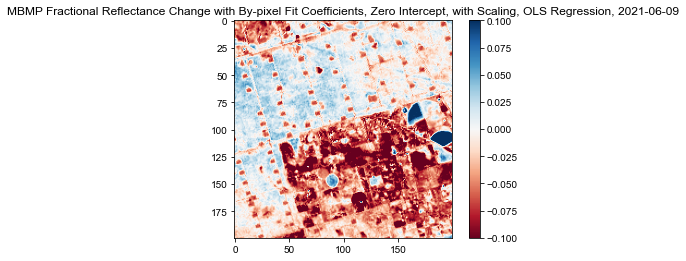

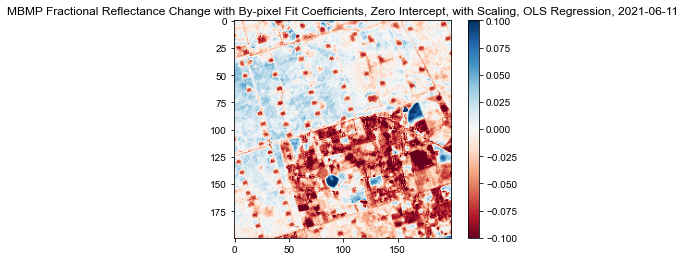

...

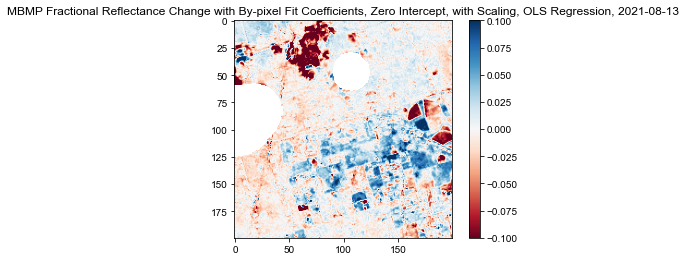

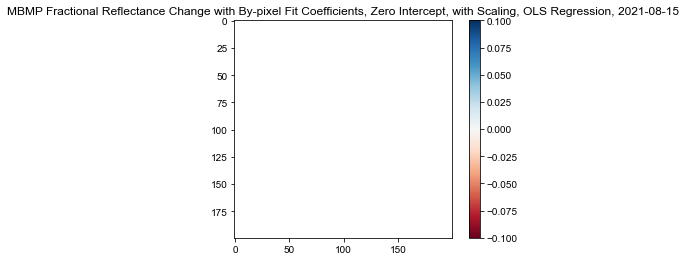

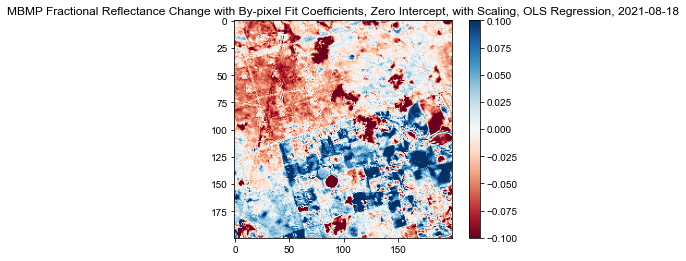

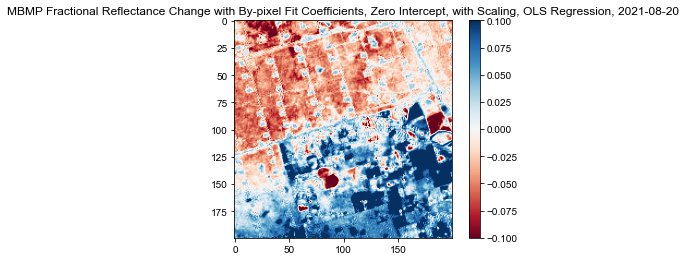

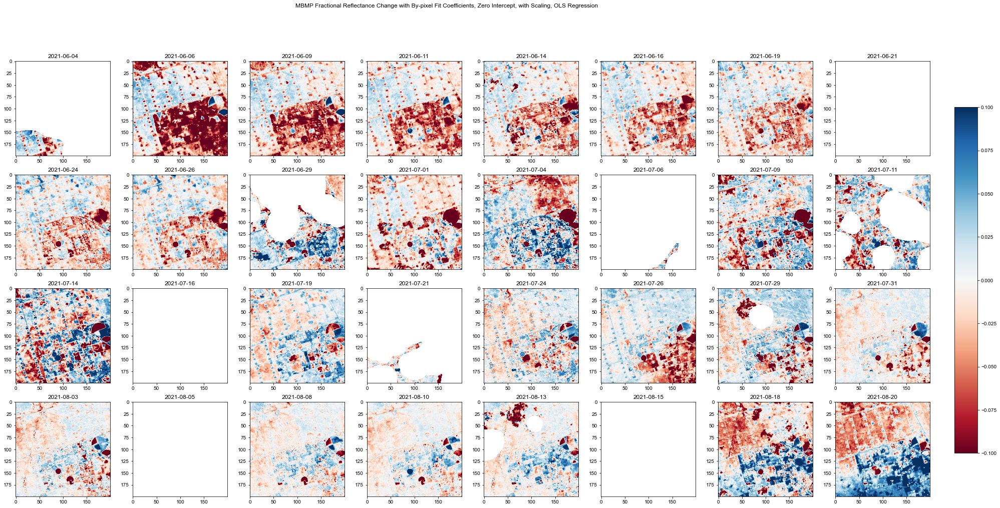

In [6]:
save_imgs = True
sup_rows,sup_cols = 4,8
supplot_dates = plume_dates[:]

####################
if factors == "Others":
    if use_scaling:
        cache_scalstan = f"/Users/DanielShen/Documents/Opportunities/2021M - Methane Research/Code/Outputs/{name}/{dates_desc}/Scaling with {others_desc}"
    else:
        cache_scalstan = f"/Users/DanielShen/Documents/Opportunities/2021M - Methane Research/Code/Outputs/{name}/{dates_desc}/Standard with {others_desc}"
elif factors == "Intercept":
    if use_scaling:
        cache_scalstan = f"/Users/DanielShen/Documents/Opportunities/2021M - Methane Research/Code/Outputs/{name}/{dates_desc}/Scaling with Intercept"
    else:
        cache_scalstan = f"/Users/DanielShen/Documents/Opportunities/2021M - Methane Research/Code/Outputs/{name}/{dates_desc}/Standard with Intercept"
else:
    if use_scaling:
        cache_scalstan = f"/Users/DanielShen/Documents/Opportunities/2021M - Methane Research/Code/Outputs/{name}/{dates_desc}/Scaling"
    else:
        cache_scalstan = f"/Users/DanielShen/Documents/Opportunities/2021M - Methane Research/Code/Outputs/{name}/{dates_desc}/Standard"
if not os.path.exists(cache_scalstan):
    os.mkdir(cache_scalstan)

cache_reg = os.path.join(cache_scalstan,reg_method)
if not os.path.exists(cache_reg):
    os.mkdir(cache_reg)

cache_plots = os.path.join(cache_reg,"Plots")
if not os.path.exists(cache_plots):
    os.mkdir(cache_plots)

if factors == "Others":
    if use_scaling:
        sup_title = f"MBMP Fractional Reflectance Change with By-pixel Fit Coefficients and {others_desc}, Zero Intercept, with Scaling, {reg_method} Regression"
    else:
        sup_title = f"MBMP Fractional Reflectance Change with By-pixel Fit Coefficients and {others_desc}, Zero Intercept, No Scaling, {reg_method} Regression"
elif factors == "Intercept":
    if use_scaling:
        sup_title = f"MBMP Fractional Reflectance Change with By-pixel Fit Coefficients, with Intercept, with Scaling, {reg_method} Regression"
    else:
        sup_title = f"MBMP Fractional Reflectance Change with By-pixel Fit Coefficients, with Intercept, No Scaling, {reg_method} Regression"
else:
    if use_scaling:
        sup_title = f"MBMP Fractional Reflectance Change with By-pixel Fit Coefficients, Zero Intercept, with Scaling, {reg_method} Regression"
    else:
        sup_title = f"MBMP Fractional Reflectance Change with By-pixel Fit Coefficients, Zero Intercept, No Scaling, {reg_method} Regression"

for reference_date in reference_dates:
    plt.figure()
    img_title = f"{sup_title}, {reference_date}"
    plt.title(img_title)
    plt.imshow(deltaR_pixel[reference_date],cmap="RdBu",vmin=-0.1,vmax=0.1)
    plt.colorbar()
    if save_imgs:
        plt.savefig(os.path.join(cache_plots,img_title),bbox_inches="tight")
        
fig, axs = plt.subplots(sup_rows,sup_cols,figsize=(4*sup_cols,4*sup_rows))
fig.suptitle(sup_title)
for i in range(sup_rows):
    for j in range(sup_cols):
        plot_date = supplot_dates[i*sup_cols+j]
        im = axs[i,j].imshow(deltaR_pixel[plot_date],cmap="RdBu",vmin=-0.1,vmax=0.1)
        axs[i,j].set_title(plot_date)
fig.subplots_adjust(right=0.92)
cbar_ax = fig.add_axes([0.94,0.2,0.02,0.6])
fig.colorbar(im,cax=cbar_ax)
if save_imgs:
    plt.savefig(os.path.join(cache_plots,sup_title),bbox_inches="tight")

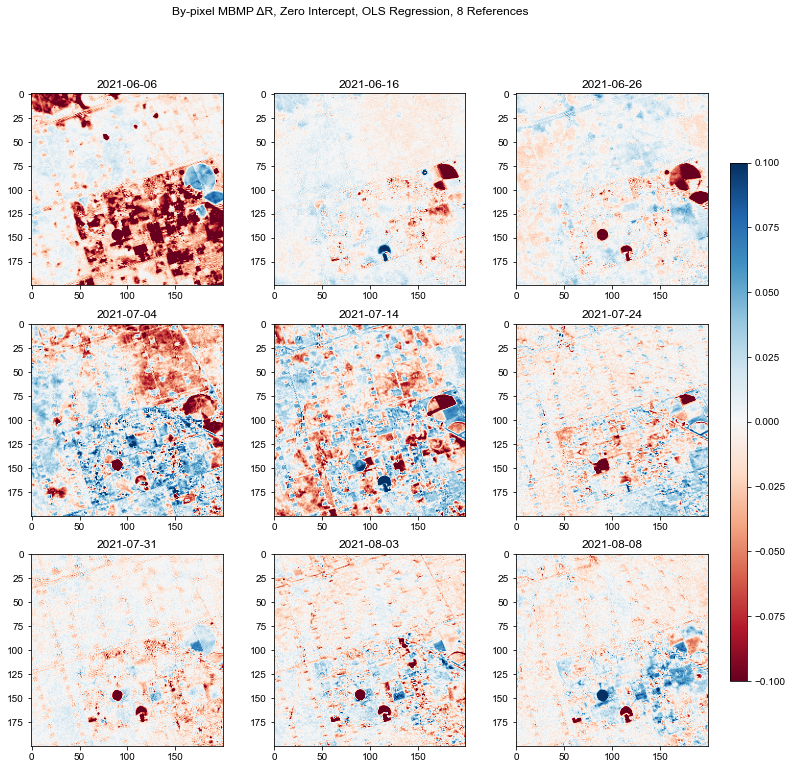

In [58]:
sup_rows,sup_cols = 3,3
#supplot_dates = ["2020-07-11","2020-07-14","2020-07-16","2020-07-29","2020-08-23","2020-08-28","2020-08-30","2020-09-07","2020-09-24"]
supplot_dates = ["2021-06-06","2021-06-16","2021-06-26","2021-07-04","2021-07-14","2021-07-24","2021-07-31","2021-08-03","2021-08-08"]

####################
fig, axs = plt.subplots(sup_rows,sup_cols,figsize=(4*sup_cols,4*sup_rows))
fig.suptitle("By-pixel MBMP ΔR, Zero Intercept, OLS Regression, 8 References")
for i in range(sup_rows):
    for j in range(sup_cols):
        plot_date = supplot_dates[i*sup_cols+j]
        im = axs[i,j].imshow(deltaR_pixelref[8][plot_date],cmap="RdBu",vmin=-0.1,vmax=0.1)
        axs[i,j].set_title(plot_date)
fig.subplots_adjust(right=0.92)
cbar_ax = fig.add_axes([0.94,0.2,0.02,0.6])
fig.colorbar(im,cax=cbar_ax)

In [53]:
deltaR_pixelref.keys()

dict_keys([10])

#### reference date selection for each date

In [7]:
# presumed to be first time; otherwise just load these variables

####################
deltaR_pixel_diff = {} # pixel-averaged squared difference for each pair of dates
deltaR_pixel_refdates = {} # reference dates for each date, ordered most similar to least similar

for date in reference_dates:
    deltaR_pixel_diff[date] = {}
    for ref_date in reference_dates:
        deltaR_pixel_diff[date][ref_date] = np.nanmean(abs(deltaR_pixel[date]-deltaR_pixel[ref_date])**2)
    deltaR_pixel_refdates[date] = sorted(deltaR_pixel_diff[date].keys(),key=lambda x:float('inf') if np.isnan(deltaR_pixel_diff[date][x]) else deltaR_pixel_diff[date][x])
deltaR_pixel_refdates

/Users/DanielShen/opt/anaconda3/envs/sentinel2_research_3.6/lib/python3.6/site-packages/ipykernel_launcher.py:10: RuntimeWarning: Mean of empty slice
  # Remove the CWD from sys.path while we load stuff.


{'2021-06-01': ['2021-06-01',
  '2021-06-04',
  '2021-06-19',
  '2021-06-24',
  '2021-06-09',
  '2021-06-11',
  '2021-06-16',
  '2021-06-06',
  '2021-06-26',
  '2021-07-06',
  '2021-07-01',
  '2021-07-31',
  '2021-07-26',
  '2021-08-08',
  '2021-08-10',
  '2021-08-03',
  '2021-07-21',
  '2021-06-14',
  '2021-07-24',
  '2021-06-29',
  '2021-07-19',
  '2021-07-29',
  '2021-07-04',
  '2021-08-13',
  '2021-08-18',
  '2021-07-11',
  '2021-07-09',
  '2021-08-20',
  '2021-07-14',
  '2021-06-21',
  '2021-07-16',
  '2021-08-05',
  '2021-08-15'],
 '2021-06-04': ['2021-06-04',
  '2021-06-11',
  '2021-06-01',
  '2021-06-16',
  '2021-06-14',
  '2021-06-09',
  '2021-06-19',
  '2021-06-06',
  '2021-06-26',
  '2021-06-24',
  '2021-08-10',
  '2021-07-31',
  '2021-08-08',
  '2021-08-03',
  '2021-08-13',
  '2021-07-26',
  '2021-07-04',
  '2021-07-01',
  '2021-07-29',
  '2021-07-24',
  '2021-06-29',
  '2021-07-19',
  '2021-07-09',
  '2021-08-18',
  '2021-07-21',
  '2021-08-20',
  '2021-07-11',
  '2021-07-

#### recomputation based on selected reference dates

In [8]:
# currently only for factors = "None" and reg_method = OLS, LAD

num_ref = range(8,9)
first_time = True

####################
#r2,c = np.empty((2,200,200)) # zero-intercept regressions of B11 vs. B12
#r2_int,c_int,d_int = np.empty((3,200,200)) # with-intercept regressions of B11 vs. B12
#r2_others,c_b12,c_sza,c_b12b12,c_b12sza,c_szasza,c_sin,c_cos = np.empty((8,200,200)) # zero-intercept regressions of B11 vs. B12 & other factors

if first_time:
    deltaR_pixelref,deltaM_pixelref = {},{} # computed delta R and delta M (methane; negative of delta R) for each date
    r2_ref,c_ref = {},{}

t0 = time.time()
for num in num_ref:
    deltaR_pixelref[num],deltaM_pixelref[num] = {},{}
    r2_ref[num],c_ref[num] = {},{}
    for i in range(len(reference_dates)):
        date = reference_dates[i]
        print(num, str(i+1) + "/" + str(len(reference_dates)), date)
        r2_ref[num][date],c_ref[num][date] = np.empty((2,200,200))
        for i in range(200):
            if i%10 == 0:
                print(i,time.time()-t0)
            for j in range(200):
                b11_pixel,b12_pixel = np.array([[],[]]) # reflectances of particular pixel over all passes
                date_counter = 0
                if factors == "Others":
                    sza_pixel,b12b12_pixel,b12sza_pixel,szasza_pixel,sin_pixel,cos_pixel = np.array([[],[],[],[],[],[]])
                for reference_date in deltaR_pixel_refdates[date][:num]:
                    if cloud[reference_date][i,j] == 0: # check for cloud nan; METHODOLOGY CHOICE to come after
                        if use_scaling:
                            b11_pixel = np.append(b11_pixel,b11[reference_date][i,j]/b11_avg[reference_date])
                            b12_pixel = np.append(b12_pixel,b12[reference_date][i,j]/b12_avg[reference_date])
                        else:
                            b11_pixel = np.append(b11_pixel,b11[reference_date][i,j])
                            b12_pixel = np.append(b12_pixel,b12[reference_date][i,j])
                        if factors == "Others":
                            sza_pixel = np.append(sza_pixel,sza_dict[reference_date])
                if factors == "Others":
                    b12b12_pixel = b12_pixel**2
                    b12sza_pixel = b12_pixel*sza_pixel
                    szasza_pixel = sza_pixel**2
                    sin_pixel = np.sin(np.radians(sza_pixel))
                    cos_pixel = np.cos(np.radians(sza_pixel))

                if factors == "Others":
                    if reg_method == "OLS":
                        reg_others = sm.OLS(b11_pixel,np.concatenate((b12_pixel.reshape(-1,1),sza_pixel.reshape(-1,1),\
                            b12b12_pixel.reshape(-1,1),b12sza_pixel.reshape(-1,1),szasza_pixel.reshape(-1,1),\
                            sin_pixel.reshape(-1,1),cos_pixel.reshape(-1,1)),axis=1)).fit()
                        r2_others[i,j] = reg_others.rsquared
                        c_b12[i,j],c_sza[i,j],c_b12b12[i,j],c_b12sza[i,j],c_szasza[i,j],c_sin[i,j],c_cos[i,j] = reg_others.params
                    elif reg_method == "LAD":
                        reg_others = sm.QuantReg(b11_pixel,np.concatenate((b12_pixel.reshape(-1,1),sza_pixel.reshape(-1,1),\
                            b12b12_pixel.reshape(-1,1),b12sza_pixel.reshape(-1,1),szasza_pixel.reshape(-1,1),\
                            sin_pixel.reshape(-1,1),cos_pixel.reshape(-1,1)),axis=1)).fit(q=0.5)
                        r2_others[i,j] = reg_others.prsquared
                        c_b12[i,j],c_sza[i,j],c_b12b12[i,j],c_b12sza[i,j],c_szasza[i,j],c_sin[i,j],c_cos[i,j] = reg_others.params
                    elif reg_method == "Huber":
                        reg_others = HuberRegressor(fit_intercept=False).fit(np.concatenate((b12_pixel.reshape(-1,1),\
                            sza_pixel.reshape(-1,1),b12b12_pixel.reshape(-1,1),b12sza_pixel.reshape(-1,1),\
                            szasza_pixel.reshape(-1,1),sin_pixel.reshape(-1,1),cos_pixel.reshape(-1,1)),axis=1),b11_pixel)
                        c_b12[i,j],c_sza[i,j],c_b12b12[i,j],c_b12sza[i,j],c_szasza[i,j],c_sin[i,j],c_cos[i,j] = reg_others.coef_
                    elif reg_method == "Ridge":
                        reg_others = Ridge(fit_intercept=False).fit(np.concatenate((b12_pixel.reshape(-1,1),\
                            sza_pixel.reshape(-1,1),b12b12_pixel.reshape(-1,1),b12sza_pixel.reshape(-1,1),\
                            szasza_pixel.reshape(-1,1),sin_pixel.reshape(-1,1),cos_pixel.reshape(-1,1)),axis=1),b11_pixel)
                        c_b12[i,j],c_sza[i,j],c_b12b12[i,j],c_b12sza[i,j],c_szasza[i,j],c_sin[i,j],c_cos[i,j] = reg_others.coef_
                elif factors == "Intercept":
                    if reg_method == "OLS":
                        reg_int = sm.OLS(b11_pixel,sm.add_constant(b12_pixel)).fit()
                        r2_int[i,j] = reg_int.rsquared
                        d_int[i,j],c_int[i,j] = reg_int.params
                    elif reg_method == "LAD":
                        reg_int = sm.QuantReg(b11_pixel,sm.add_constant(b12_pixel)).fit(q=0.5)
                        r2_int[i,j] = reg_int.prsquared
                        d_int[i,j],c_int[i,j] = reg_int.params
                    elif reg_method == "Huber":
                        reg_int = HuberRegressor().fit(b12_pixel.reshape(-1,1),b11_pixel)
                        c_int[i,j] = reg_int.coef_
                        d_int[i,j] = reg_int.intercept_
                    elif reg_method == "Ridge":
                        reg_int = Ridge().fit(b12_pixel.reshape(-1,1),b11_pixel)
                        c_int[i,j] = reg_int.coef_
                        d_int[i,j] = reg_int.intercept_
                elif factors == "None":
                    if reg_method == "OLS":
                        reg = sm.OLS(b11_pixel,b12_pixel).fit()
                        r2_ref[num][date][i,j] = reg.rsquared
                        c_ref[num][date][i,j] = reg.params[0]
                    elif reg_method == "LAD":
                        reg = sm.QuantReg(b11_pixel,b12_pixel).fit(q=0.5) # can increase tolerance to run faster
                        r2_ref[num][date][i,j] = reg.prsquared
                        c_ref[num][date][i,j] = reg.params[0]
                    elif reg_method == "Huber":
                        reg = HuberRegressor(fit_intercept=False).fit(b12_pixel.reshape(-1,1),b11_pixel) # can increase tolerance to run faster
                        c_ref[num][date][i,j] = reg.coef_
                    elif reg_method == "Ridge":
                        reg = Ridge(fit_intercept=False).fit(b12_pixel.reshape(-1,1),b11_pixel) # can increase tolerance to run faster
                        c_ref[num][date][i,j] = reg.coef_
        if factors == "Others":
            if use_scaling:
                deltaR_pixel[reference_date] = (np.multiply(c_b12,b12[reference_date]/b12_avg[reference_date]) + c_sza*sza_dict[reference_date] \
                                            + np.multiply(c_b12b12,(b12[reference_date]/b12_avg[reference_date])**2) + np.multiply(c_b12sza,b12[reference_date]/b12_avg[reference_date]*sza_dict[reference_date]) \
                                            + c_szasza*sza_dict[reference_date]**2 + c_sin*np.sin(np.radians(sza_dict[reference_date])) + c_cos*np.cos(np.radians(sza_dict[reference_date])) \
                                            - b11[reference_date]/b11_avg[reference_date]) / (b11[reference_date]/b11_avg[reference_date])
            else:
                deltaR_pixel[reference_date] = (np.multiply(c_b12,b12[reference_date]) + c_sza*sza_dict[reference_date] \
                                            + np.multiply(c_b12b12,b12[reference_date]**2) + np.multiply(c_b12sza,b12[reference_date]*sza_dict[reference_date]) \
                                            + c_szasza*sza_dict[reference_date]**2 + c_sin*np.sin(np.radians(sza_dict[reference_date])) + c_cos*np.cos(np.radians(sza_dict[reference_date])) \
                                            - b11[reference_date]) / b11[reference_date]
        elif factors == "Intercept":
            if use_scaling:
                deltaR_pixel[reference_date] = (np.multiply(c_int,b12[reference_date]/b12_avg[reference_date]) + d_int - b11[reference_date]/b11_avg[reference_date]) / (b11[reference_date]/b11_avg[reference_date])
            else:
                deltaR_pixel[reference_date] = (np.multiply(c_int,b12[reference_date]) + d_int - b11[reference_date]) / b11[reference_date]
        elif factors == "None":
            if use_scaling:
                deltaR_pixelref[num][date] = (np.multiply(c_ref[num][date],b12[date]/b12_avg[date]) - b11[date]/b11_avg[date]) / (b11[date]/b11_avg[date])
            else:
                deltaR_pixelref[num][date] = (np.multiply(c_ref[num][date],b12[date]) - b11[date]) / b11[date]
        deltaM_pixelref[num][date] = -deltaR_pixelref[num][date]
t1 = time.time()
print(t1-t0)

8 1/33 2021-06-01
0 0.0017783641815185547
10 1.9115912914276123
20 3.8320860862731934
30 5.370882034301758
40 7.775220155715942
50 9.2170991897583
60 10.683342218399048
70 12.30465316772461
80 14.9532151222229
90 16.689463138580322
100 18.234844207763672
110 19.624983072280884
120 20.99918007850647
130 23.07517433166504
140 24.39264225959778
150 25.52671217918396
160 26.756378173828125
170 28.29567003250122
180 31.692087173461914
190 34.171794176101685
8 2/33 2021-06-04
0 35.53895115852356
10 36.830926179885864
20 38.67988920211792
30 40.07508111000061
40 41.67512822151184
50 43.239333152770996
60 44.96516299247742
70 47.36376714706421
80 49.224372148513794
90 51.23559617996216
100 52.43106722831726
110 53.56436610221863
120 54.75671720504761
130 55.90430426597595
140 57.1069393157959
150 58.46541905403137
160 59.645180225372314
170 60.77074837684631
180 61.92856216430664
190 63.11910128593445
8 3/33 2021-06-06
0 64.33152318000793
10 65.5799560546875
20 67.08043718338013
30 68.33850121

190 451.6759731769562
8 19/33 2021-07-16
0 452.8668041229248
10 454.0701403617859
20 455.21077513694763
30 456.36256313323975
40 457.51971316337585
50 458.6703963279724
60 459.84606432914734
70 460.9595603942871
80 462.0723731517792
90 463.242032289505
100 464.37151432037354
110 465.52675318717957
120 466.64916825294495
130 467.77771520614624
140 468.91808009147644
150 470.0365493297577
160 471.1672623157501
170 472.5135040283203
180 473.8264901638031
190 474.98069310188293
8 20/33 2021-07-19
0 476.19074010849
10 477.3765161037445
20 478.576621055603
30 479.7162160873413
40 480.8780221939087
50 481.983056306839
60 483.1948673725128
70 484.395259141922
80 485.55140209198
90 486.7410271167755
100 487.8949933052063
110 489.08321619033813
120 490.297904253006
130 491.4763741493225
140 492.9523813724518
150 494.2867052555084
160 495.4902663230896
170 496.70058822631836
180 497.8578450679779
190 499.025000333786
8 21/33 2021-07-21
0 500.21092414855957
10 501.3514120578766
20 502.469636201858

#### save variables

In [9]:
####################
if factors == "Others":
    if use_scaling:
        cache_scalstan = f"/Users/DanielShen/Documents/Opportunities/2021M - Methane Research/Code/Outputs/{name}/{dates_desc}/Scaling with {others_desc}"
    else:
        cache_scalstan = f"/Users/DanielShen/Documents/Opportunities/2021M - Methane Research/Code/Outputs/{name}/{dates_desc}/Standard with {others_desc}"
elif factors == "Intercept":
    if use_scaling:
        cache_scalstan = f"/Users/DanielShen/Documents/Opportunities/2021M - Methane Research/Code/Outputs/{name}/{dates_desc}/Scaling with Intercept"
    else:
        cache_scalstan = f"/Users/DanielShen/Documents/Opportunities/2021M - Methane Research/Code/Outputs/{name}/{dates_desc}/Standard with Intercept"
else:
    if use_scaling:
        cache_scalstan = f"/Users/DanielShen/Documents/Opportunities/2021M - Methane Research/Code/Outputs/{name}/{dates_desc}/Scaling"
    else:
        cache_scalstan = f"/Users/DanielShen/Documents/Opportunities/2021M - Methane Research/Code/Outputs/{name}/{dates_desc}/Standard"
if not os.path.exists(cache_scalstan):
    os.mkdir(cache_scalstan)

cache_reg = os.path.join(cache_scalstan,reg_method)
if not os.path.exists(cache_reg):
    os.mkdir(cache_reg)

cache_vars = os.path.join(cache_reg,"Variables")
if not os.path.exists(cache_vars):
    os.mkdir(cache_vars)

pkl.dump(deltaR_pixel_diff,open(os.path.join(cache_vars,"deltaR_pixel_diff"),'wb'))
pkl.dump(deltaR_pixel_refdates,open(os.path.join(cache_vars,"deltaR_pixel_refdates"),'wb'))
pkl.dump(deltaR_pixelref,open(os.path.join(cache_vars,"deltaR_pixelref"),'wb'))
pkl.dump(deltaM_pixelref,open(os.path.join(cache_vars,"deltaM_pixelref"),'wb'))
if factors == "Others":
    np.save(os.path.join(cache_vars,"r2_others"),r2_others)
    np.save(os.path.join(cache_vars,"c_b12"),c_b12)
    np.save(os.path.join(cache_vars,"c_sza"),c_sza)
    np.save(os.path.join(cache_vars,"c_b12b12"),c_b12b12)
    np.save(os.path.join(cache_vars,"c_b12sza"),c_b12sza)
    np.save(os.path.join(cache_vars,"c_szasza"),c_szasza)
    np.save(os.path.join(cache_vars,"c_sin"),c_sin)
    np.save(os.path.join(cache_vars,"c_cos"),c_cos)
elif factors == "Intercept":
    np.save(os.path.join(cache_vars,"r2_int"),r2_int)
    np.save(os.path.join(cache_vars,"c_int"),c_int)
    np.save(os.path.join(cache_vars,"d_int"),d_int)
else:
    pkl.dump(r2_ref,open(os.path.join(cache_vars,"r2_ref"),'wb'))
    pkl.dump(c_ref,open(os.path.join(cache_vars,"c_ref"),'wb'))

#### load variables

In [56]:
use_scaling = True
factors = "None" # ["Others","Intercept","None"]; only "None" for now
others_desc = "Quadratic and Trigonometric SZA Factors"
reg_method = "OLS" # ["OLS","LAD","Huber","Ridge"]; only OLS, LAD for now

####################
if factors == "Others":
    if use_scaling:
        cache_vars = f"/Users/DanielShen/Documents/Opportunities/2021M - Methane Research/Code/Outputs/{name}/{dates_desc}/Scaling with {others_desc}/{reg_method}/Variables"
    else:
        cache_vars = f"/Users/DanielShen/Documents/Opportunities/2021M - Methane Research/Code/Outputs/{name}/{dates_desc}/Standard with {others_desc}/{reg_method}/Variables"
elif factors == "Intercept":
    if use_scaling:
        cache_vars = f"/Users/DanielShen/Documents/Opportunities/2021M - Methane Research/Code/Outputs/{name}/{dates_desc}/Scaling with Intercept/{reg_method}/Variables"
    else:
        cache_vars = f"/Users/DanielShen/Documents/Opportunities/2021M - Methane Research/Code/Outputs/{name}/{dates_desc}/Standard with Intercept/{reg_method}/Variables"
elif factors == "None":
    if use_scaling:
        cache_vars = f"/Users/DanielShen/Documents/Opportunities/2021M - Methane Research/Code/Outputs/{name}/{dates_desc}/Scaling/{reg_method}/Variables"
    else:
        cache_vars = f"/Users/DanielShen/Documents/Opportunities/2021M - Methane Research/Code/Outputs/{name}/{dates_desc}/Standard/{reg_method}/Variables"

deltaR_pixel_diff = pkl.load(open(os.path.join(cache_vars,"deltaR_pixel_diff"),'rb'))
deltaR_pixel_refdates = pkl.load(open(os.path.join(cache_vars,"deltaR_pixel_refdates"),'rb'))
deltaR_pixelref = pkl.load(open(os.path.join(cache_vars,"deltaR_pixelref"),'rb'))
deltaM_pixelref = pkl.load(open(os.path.join(cache_vars,"deltaM_pixelref"),'rb'))
if factors == "Others":
    r2_others = np.load(os.path.join(cache_vars,"r2_others.npy"))
    c_b12 = np.load(os.path.join(cache_vars,"c_b12.npy"))
    c_sza = np.load(os.path.join(cache_vars,"c_sza.npy"))
    c_b12b12 = np.load(os.path.join(cache_vars,"c_b12b12.npy"))
    c_b12sza = np.load(os.path.join(cache_vars,"c_b12sza.npy"))
    c_szasza = np.load(os.path.join(cache_vars,"c_szasza.npy"))
    c_sin = np.load(os.path.join(cache_vars,"c_sin.npy"))
    c_cos = np.load(os.path.join(cache_vars,"c_cos.npy"))
elif factors == "Intercept":
    r2_int = np.load(os.path.join(cache_vars,"r2_int.npy"))
    c_int = np.load(os.path.join(cache_vars,"c_int.npy"))
    d_int = np.load(os.path.join(cache_vars,"d_int.npy"))
else:
    r2_ref = pkl.load(open(os.path.join(cache_vars,"r2_ref"),'rb'))
    c_ref = pkl.load(open(os.path.join(cache_vars,"c_ref"),'rb'))

#### plot (and save)

/Users/DanielShen/opt/anaconda3/envs/sentinel2_research_3.6/lib/python3.6/site-packages/ipykernel_launcher.py:50: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


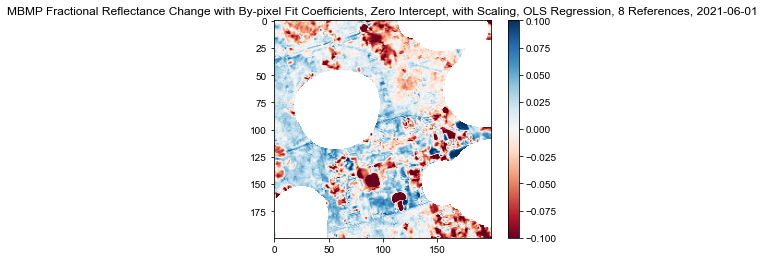

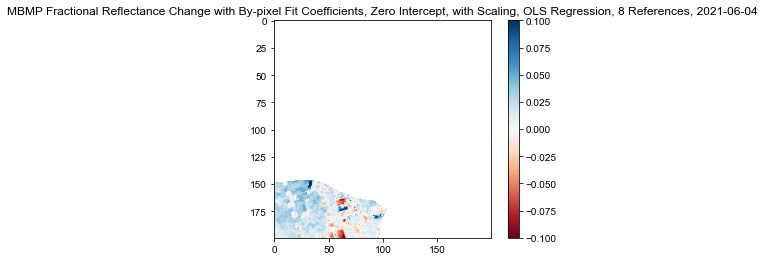

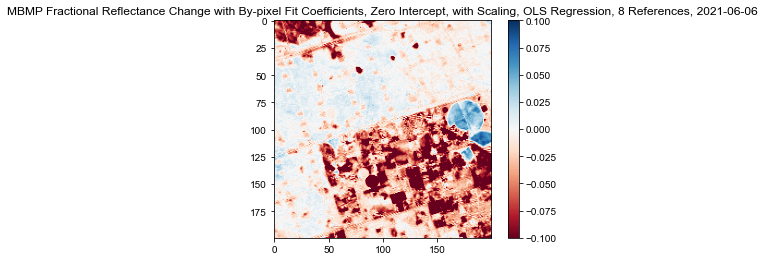

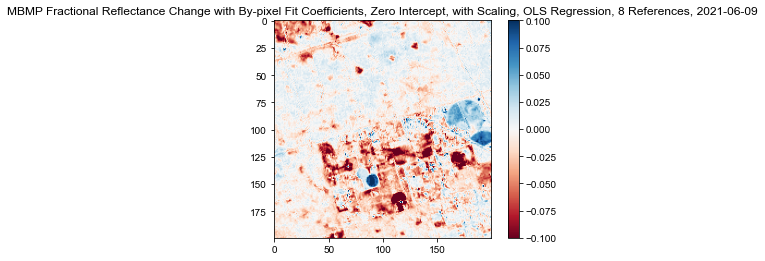

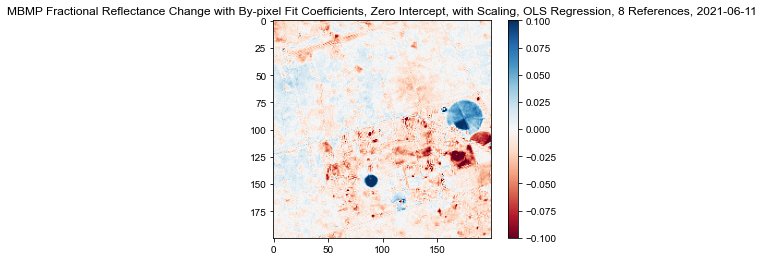

...

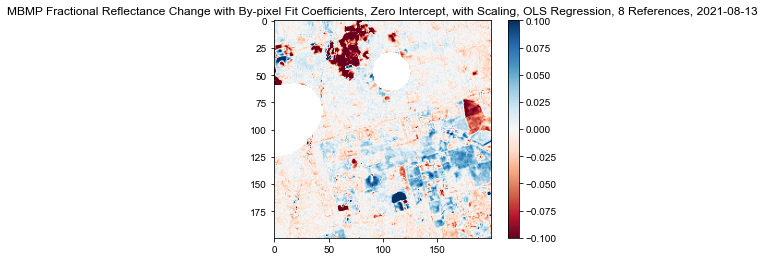

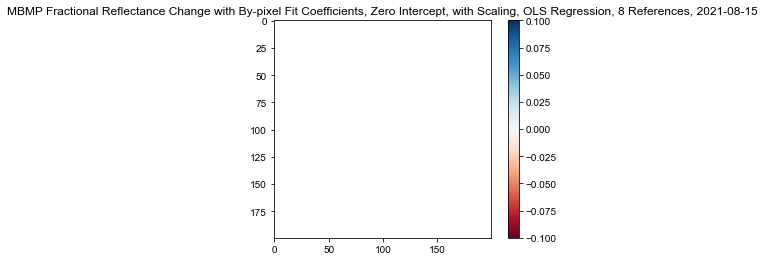

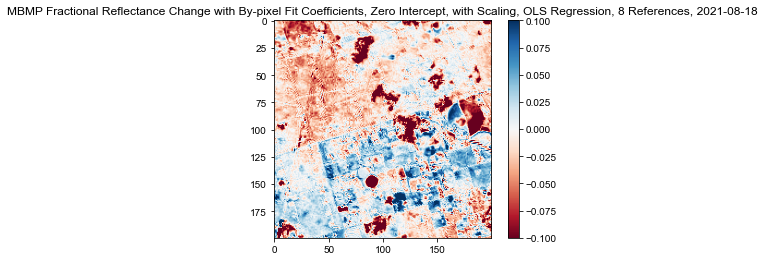

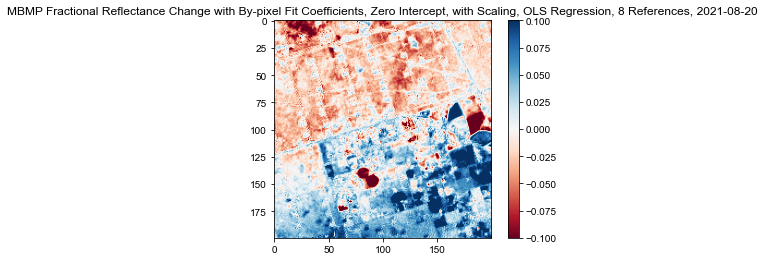

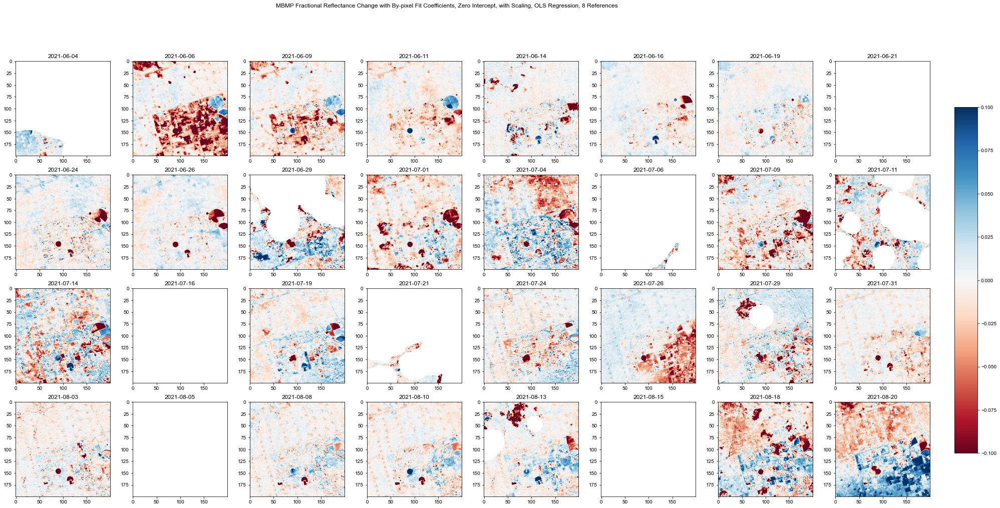

In [10]:
save_imgs = True
sup_rows,sup_cols = 4,8
supplot_dates = plume_dates[:]

####################
if factors == "Others":
    if use_scaling:
        cache_scalstan = f"/Users/DanielShen/Documents/Opportunities/2021M - Methane Research/Code/Outputs/{name}/{dates_desc}/Scaling with {others_desc}"
    else:
        cache_scalstan = f"/Users/DanielShen/Documents/Opportunities/2021M - Methane Research/Code/Outputs/{name}/{dates_desc}/Standard with {others_desc}"
elif factors == "Intercept":
    if use_scaling:
        cache_scalstan = f"/Users/DanielShen/Documents/Opportunities/2021M - Methane Research/Code/Outputs/{name}/{dates_desc}/Scaling with Intercept"
    else:
        cache_scalstan = f"/Users/DanielShen/Documents/Opportunities/2021M - Methane Research/Code/Outputs/{name}/{dates_desc}/Standard with Intercept"
else:
    if use_scaling:
        cache_scalstan = f"/Users/DanielShen/Documents/Opportunities/2021M - Methane Research/Code/Outputs/{name}/{dates_desc}/Scaling"
    else:
        cache_scalstan = f"/Users/DanielShen/Documents/Opportunities/2021M - Methane Research/Code/Outputs/{name}/{dates_desc}/Standard"
if not os.path.exists(cache_scalstan):
    os.mkdir(cache_scalstan)

cache_reg = os.path.join(cache_scalstan,reg_method)
if not os.path.exists(cache_reg):
    os.mkdir(cache_reg)

cache_plots = os.path.join(cache_reg,"Plots")
if not os.path.exists(cache_plots):
    os.mkdir(cache_plots)

for num in deltaR_pixelref.keys():
    if factors == "Others":
        if use_scaling:
            sup_title = f"MBMP Fractional Reflectance Change with By-pixel Fit Coefficients and {others_desc}, Zero Intercept, with Scaling, {reg_method} Regression, {num} References"
        else:
            sup_title = f"MBMP Fractional Reflectance Change with By-pixel Fit Coefficients and {others_desc}, Zero Intercept, No Scaling, {reg_method} Regression, {num} References"
    elif factors == "Intercept":
        if use_scaling:
            sup_title = f"MBMP Fractional Reflectance Change with By-pixel Fit Coefficients, with Intercept, with Scaling, {reg_method} Regression, {num} References"
        else:
            sup_title = f"MBMP Fractional Reflectance Change with By-pixel Fit Coefficients, with Intercept, No Scaling, {reg_method} Regression, {num} References"
    else:
        if use_scaling:
            sup_title = f"MBMP Fractional Reflectance Change with By-pixel Fit Coefficients, Zero Intercept, with Scaling, {reg_method} Regression, {num} References"
        else:
            sup_title = f"MBMP Fractional Reflectance Change with By-pixel Fit Coefficients, Zero Intercept, No Scaling, {reg_method} Regression, {num} References"

    for reference_date in reference_dates:
        plt.figure()
        img_title = f"{sup_title}, {reference_date}"
        plt.title(img_title)
        plt.imshow(deltaR_pixelref[num][reference_date],cmap="RdBu",vmin=-0.1,vmax=0.1)
        plt.colorbar()
        if save_imgs:
            plt.savefig(os.path.join(cache_plots,img_title),bbox_inches="tight")

    fig, axs = plt.subplots(sup_rows,sup_cols,figsize=(4*sup_cols,4*sup_rows))
    fig.suptitle(sup_title)
    for i in range(sup_rows):
        for j in range(sup_cols):
            plot_date = supplot_dates[i*sup_cols+j]
            im = axs[i,j].imshow(deltaR_pixelref[num][plot_date],cmap="RdBu",vmin=-0.1,vmax=0.1)
            axs[i,j].set_title(plot_date)
    fig.subplots_adjust(right=0.92)
    cbar_ax = fig.add_axes([0.94,0.2,0.02,0.6])
    fig.colorbar(im,cax=cbar_ax)
    if save_imgs:
        plt.savefig(os.path.join(cache_plots,sup_title),bbox_inches="tight")

#### evaluate r2 vs. r2_others

In [98]:
print(np.mean(r2))
print(np.mean(r2_others))

0.9999367929926655
0.9999780267611688


### evaluating noise of scene-wide vs. by-pixel MBMP

In [28]:
# uses deltaR_MBMP and deltaR_pixel (with deltaM_MBMP and deltaM_pixel) from previous sections
use_mask = False
use_ref = True
num = 8
dates_to_eval = reference_dates[:]

####################
deltaR_MBMP_no_plume = deltaR_MBMP.copy()
deltaR_pixel_no_plume = deltaR_pixel.copy()
deltaR_MBMP_std = {}
deltaR_pixel_std = {}
deltaR_prc_diff_std = {}

if use_mask:
    plume_data = pd.read_csv('plume_data.csv')
    plume_data = plume_data[plume_data.Tile == name]
    for index,e in plume_data.iterrows():
        deltaR_MBMP_masked[e.Date][e.Reference][clean_threshold_mask(build_threshold_mask(\
            deltaM_MBMP[e.Date][e.Reference],e.threshold),100,100,e.dru,e.drd,e.dcl,e.dcr)==1] = float('nan')
        deltaR_pixel_masked[e.Date][clean_threshold_mask(build_threshold_mask(\
            deltaM_pixel[e.Date],e.threshold),100,100,e.dru,e.drd,e.dcl,e.dcr)==1] = float('nan')
        if e.Date not in deltaR_MBMP_std.keys():
            deltaR_MBMP_std[e.Date] = {}
            deltaR_prc_diff_std[e.Date] = {}
        deltaR_MBMP_std[e.Date][e.Reference] = np.nanstd(deltaR_MBMP_masked[e.Date][e.Reference])
        deltaR_pixel_std[e.Date] = np.nanstd(deltaR_pixel_masked[e.Date])
        deltaR_prc_diff_std[e.Date][e.Reference] = deltaR_pixel_std[e.Date]/deltaR_MBMP_std[e.Date][e.Reference] - 1
else:
    if use_ref:
        for date in dates_to_eval:
            deltaR_MBMP_std[date] = np.nanstd(deltaR_MBMP_opt[date])
            deltaR_pixel_std[date] = np.nanstd(deltaR_pixelref[num][date])
            deltaR_prc_diff_std[date] = deltaR_pixel_std[date]/deltaR_MBMP_std[date] - 1
    else:
        for date in dates_to_eval:
            deltaR_MBMP_std[date] = np.nanstd(deltaR_MBMP_opt[date])
            deltaR_pixel_std[date] = np.nanstd(deltaR_pixel[date])
            deltaR_prc_diff_std[date] = deltaR_pixel_std[date]/deltaR_MBMP_std[date] - 1

print(deltaR_prc_diff_std)
print(np.nanmean(np.array(list(deltaR_prc_diff_std.values()))))

{'2021-06-01': 0.22954868593122035, '2021-06-04': -0.07351347016457277, '2021-06-06': 0.9391163716456057, '2021-06-09': -0.07856086343421831, '2021-06-11': -0.28561638932904276, '2021-06-14': 0.29478149779436214, '2021-06-16': -0.2231395737140478, '2021-06-19': -0.3057670654182706, '2021-06-21': nan, '2021-06-24': -0.03416948880066595, '2021-06-26': 0.07431298283365884, '2021-06-29': -0.257747954609011, '2021-07-01': -0.07595139019610364, '2021-07-04': -0.1527327777353148, '2021-07-06': -0.1436214205432571, '2021-07-09': 0.13274321005017264, '2021-07-11': -0.009359784088644019, '2021-07-14': 0.06632699051493152, '2021-07-16': nan, '2021-07-19': -0.2918658969643716, '2021-07-21': -0.08779439408004264, '2021-07-24': -0.18489336346390106, '2021-07-26': -0.08269529087837846, '2021-07-29': -0.07654987148939996, '2021-07-31': -0.20866263046919076, '2021-08-03': 0.03490677890372229, '2021-08-05': nan, '2021-08-08': -0.1730894031778879}
-0.03895978043530591


### b11 vs. b12 over time for specified pixel

In [ ]:
# uses c, c_int, d_int from section above

color_all = False
#rows,cols = range(0,200,50),range(0,200,50)
rows,cols = range(86,103),range(100,101)
#rows,cols = range(95,97),range(170,172)
#rows,cols = range(71,74),range(152,155) # 32SKA flare location

plume_dates = ["2019-11-20","2019-11-30","2019-12-03"]
non_plume_dates = ["2019-10-11","2019-12-20","2020-01-17","2019-10-14","2019-10-16","2019-10-21","2019-01-17","2019-02-16","2019-03-18","2019-04-17","2019-05-17","2019-06-16","2019-07-06","2019-07-11","2019-07-16","2019-07-23","2019-07-28","2019-08-02","2019-08-10","2019-08-17","2019-08-22","2019-08-27","2019-09-01","2019-09-11","2019-09-14","2019-09-16","2019-09-19","2019-09-24","2019-09-26","2019-09-29","2019-10-01","2019-10-04","2019-10-06"]
reference_dates = plume_dates+non_plume_dates

####################
for i in rows:
    for j in cols:
        # reflectances of particular pixel over various non-plume passes
        if not use_scaling:
            b11_pixel_all = np.array([b11[reference_date][i,j] for reference_date in reference_dates])
            b12_pixel_all = np.array([b12[reference_date][i,j] for reference_date in reference_dates])
            b11_pixel_non_plume = np.array([b11[non_plume_date][i,j] for non_plume_date in non_plume_dates])
            b12_pixel_non_plume = np.array([b12[non_plume_date][i,j] for non_plume_date in non_plume_dates])
        else:
            b11_pixel_all = np.array([b11[reference_date][i,j]/b11_avg[reference_date] for reference_date in reference_dates])
            b12_pixel_all = np.array([b12[reference_date][i,j]/b12_avg[reference_date] for reference_date in reference_dates])
            b11_pixel_non_plume = np.array([b11[non_plume_date][i,j]/b11_avg[non_plume_date] for non_plume_date in non_plume_dates])
            b12_pixel_non_plume = np.array([b12[non_plume_date][i,j]/b12_avg[non_plume_date] for non_plume_date in non_plume_dates])            
        
        plt.figure()
        if color_all:
            plt.scatter(b12_pixel_all,b11_pixel_all,s=10,c=range(len(reference_dates)),cmap="gist_rainbow")
        else:
            plt.plot(b12_pixel_non_plume,b11_pixel_non_plume,'b.',label="non-plume")
            for k in range(len(plume_dates)):
                plt.plot(b12[plume_dates[k]][i,j],b11[plume_dates[k]][i,j],'.',color="rygm"[k],label=f"plume ({plume_dates[k]})")
        b12_lin = np.linspace(min(b12_pixel_all),max(b12_pixel_all))
        plt.plot(b12_lin,c[i][j]*b12_lin.reshape(-1,1),'k-')
#        plt.plot(b12_lin,c[i][j]*b12_lin.reshape(-1,1),'b-',label="zero-intercept regression")
#        plt.plot(b12_lin,c_int[i][j]*b12_lin.reshape(-1,1)+d_int[i][j],'b:',label="with-intercept regression")
        plt.xlabel("B12")
        plt.ylabel("B11")
        plt.title(f"B11 vs. B12 Reflectances at ({i}, {j}), {reg_method} Regression")
        plt.legend(bbox_to_anchor=(1.04,1), loc="upper left")

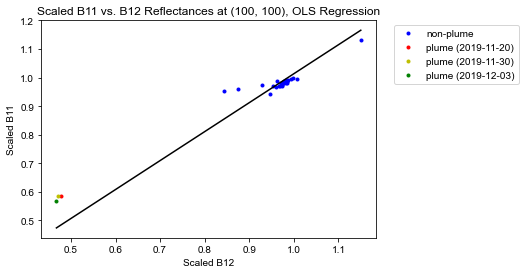

In [42]:
for i in range(100,101):
    for j in range(100,101):
        # reflectances of particular pixel over various non-plume passes
        if not use_scaling:
            b11_pixel_all = np.array([b11[reference_date][i,j] for reference_date in reference_dates])
            b12_pixel_all = np.array([b12[reference_date][i,j] for reference_date in reference_dates])
            b11_pixel_non_plume = np.array([b11[non_plume_date][i,j] for non_plume_date in non_plume_dates])
            b12_pixel_non_plume = np.array([b12[non_plume_date][i,j] for non_plume_date in non_plume_dates])
        else:
            b11_pixel_all = np.array([b11[reference_date][i,j]/b11_avg[reference_date] for reference_date in reference_dates])
            b12_pixel_all = np.array([b12[reference_date][i,j]/b12_avg[reference_date] for reference_date in reference_dates])
            b11_pixel_non_plume = np.array([b11[non_plume_date][i,j]/b11_avg[non_plume_date] for non_plume_date in non_plume_dates])
            b12_pixel_non_plume = np.array([b12[non_plume_date][i,j]/b12_avg[non_plume_date] for non_plume_date in non_plume_dates])            
        
        plt.figure()
        if color_all:
            plt.scatter(b12_pixel_all,b11_pixel_all,s=10,c=range(len(reference_dates)),cmap="gist_rainbow")
        else:
            plt.plot(b12_pixel_non_plume,b11_pixel_non_plume,'b.',label="non-plume")
            for k in range(len(plume_dates)):
                plt.plot(b12[plume_dates[k]][i,j],b11[plume_dates[k]][i,j],'.',color="rygm"[k],label=f"plume ({plume_dates[k]})")
        b12_lin = np.linspace(0.4675,max(b12_pixel_all))
        plt.plot(b12_lin,c[i][j]*b12_lin.reshape(-1,1),'k-')
#        plt.plot(b12_lin,c[i][j]*b12_lin.reshape(-1,1),'b-',label="zero-intercept regression")
#        plt.plot(b12_lin,c_int[i][j]*b12_lin.reshape(-1,1)+d_int[i][j],'b:',label="with-intercept regression")
        plt.xlabel("Scaled B12")
        plt.ylabel("Scaled B11")
        plt.title(f"Scaled B11 vs. B12 Reflectances at ({i}, {j}), {reg_method} Regression")
        plt.legend(bbox_to_anchor=(1.04,1), loc="upper left")

In [40]:
b12["2019-12-03"][100][100]

0.4675

### residual of B11 minus B12 prediction vs. SZA

In [ ]:
# uses c, use_scaling from section above
# residual defined as model - observation

color_all = True
rows,cols = range(0,200,50),range(0,200,50)
#rows,cols = range(71,74),range(152,155) # 32SKA flare location

####################
for i in rows:
    for j in cols:
        # reflectances of particular pixel over various non-plume passes
        b11_pixel_all,b12_pixel_all,sza_pixel_all = np.array([]),np.array([]),np.array([])
        for reference_date in reference_dates:
            if cloud[reference_date][i,j] == 0: # check for cloud nan
                if use_scaling:
                    b11_pixel_all = np.append(b11_pixel_all,b11[reference_date][i,j]/b11_avg[reference_date])
                    b12_pixel_all = np.append(b12_pixel_all,b12[reference_date][i,j]/b12_avg[reference_date])
                else:
                    b11_pixel_all = np.append(b11_pixel_all,b11[reference_date][i,j])
                    b12_pixel_all = np.append(b12_pixel_all,b12[reference_date][i,j])
                sza_pixel_all = np.append(sza_pixel_all,sza_dict[reference_date])
        
        reg_sza = sm.OLS(c[i][j]*b12_pixel_all-b11_pixel_all,sm.add_constant(sza_pixel_all)).fit()
        
        plt.figure()
        plt.scatter(sza_pixel_all,c[i][j]*b12_pixel_all-b11_pixel_all,s=10,c=range(len(b11_pixel_all)),cmap="gist_rainbow")
        plt.plot(sza_pixel_all,reg_sza.params[0]+reg_sza.params[1]*sza_pixel_all,'b-')
        plt.xlabel("SZA")
        plt.ylabel("Residual")
        if use_scaling:
            plt.title(f"Residual of B11 minus B12 prediction vs. SZA at ({i}, {j}), with Scaling, {reg_method} Regression")
        else:
            plt.title(f"Residual of B11 minus B12 prediction vs. SZA at ({i}, {j}), No Scaling, {reg_method} Regression")

### heatmap of spectral fit coefficients

Text(0.5, 1.0, "Heat Map of Pixels' Fit Coefficients")

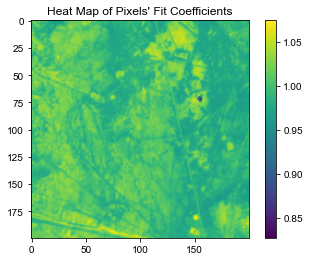

In [20]:
####################
plt.imshow(c) # heatmap for c
plt.colorbar()
plt.title("Heat Map of Pixels' Fit Coefficients")

### evaluate plumes (to save plume box)

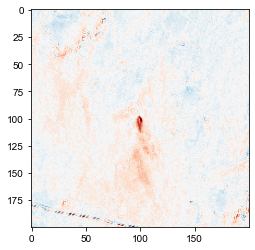

In [96]:
plume_date_index = 8
plt.imshow(deltaR_MBMP[plume_dates[plume_date_index]],cmap="RdBu",vmin=-0.1,vmax=0.1)

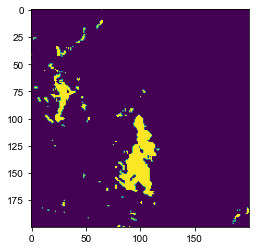

In [102]:
threshold = 92
plt.imshow(build_threshold_mask(deltaM_pixel[plume_dates[plume_date_index]],threshold))

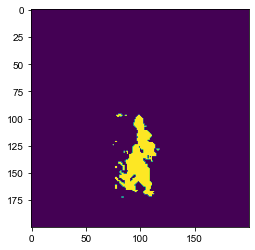

In [104]:
dru,drd,dcl,dcr = 4,75,25,20
plt.imshow(clean_threshold_mask(build_threshold_mask(deltaM_pixel[plume_dates[plume_date_index]],threshold),100,100,dru,drd,dcl,dcr))